In [66]:
import json
from pathlib import Path

In [20]:
import torch
from qwen_vl_utils import process_vision_info
from PIL import Image
from transformers import (
    AutoProcessor,
    AutoTokenizer,
    # BitsAndBytesConfig,
    # Qwen2_5_VLForConditionalGeneration,
    Qwen3VLForConditionalGeneration,
)

In [3]:
HF_TOKEN = "..."

Памяти на 7B не хватило. Пробовала 8 и 4 бит, но не помогло, поэтому скачала 2B.

In [5]:
# default: Load the model on the available device(s)
model = Qwen3VLForConditionalGeneration.from_pretrained(
    # "Qwen/Qwen2.5-VL-7B-Instruct",
    "Qwen/Qwen3-VL-2B-Instruct",
    torch_dtype="auto",
    # device_map="auto",
    device_map={"": "cuda:0"},
    token=HF_TOKEN,
    # quantization_config=quant_config,
    trust_remote_code=True,
)

Loading weights: 100%|█████████████████████████████████████████| 625/625 [00:02<00:00, 266.25it/s, Materializing param=model.visual.pos_embed.weight]


In [6]:
# default processer
processor = AutoProcessor.from_pretrained(
    # "Qwen/Qwen2.5-VL-7B-Instruct",
    "Qwen/Qwen3-VL-2B-Instruct",
)

In [59]:
torch.backends.cudnn.deterministic = True
torch.backends.cudnn.benchmark = False
torch.manual_seed(123)

In [60]:
def describe_image(image) -> str:
    messages = [
        {
            "role": "user",
            "content": [
                {"type": "image", "image": image},
                {"type": "text", "text": "Describe this image."},
            ],
        }
    ]
    
    # Preparation for inference
    text = processor.apply_chat_template(
        messages, tokenize=False, add_generation_prompt=True
    )
    inputs = processor(
        text=[text],
        images=[image],
        padding=True,
        return_tensors="pt",
    ).to("cuda")
    
    # Inference: Generation of the output
    generated_ids = model.generate(**inputs, max_new_tokens=256, do_sample=False)
    generated_ids_trimmed = generated_ids[0][inputs.input_ids.shape[1]:]
    [output_text] = processor.batch_decode(
        generated_ids_trimmed,
        skip_special_tokens=True,
        clean_up_tokenization_spaces=False,
    )

    return output_text

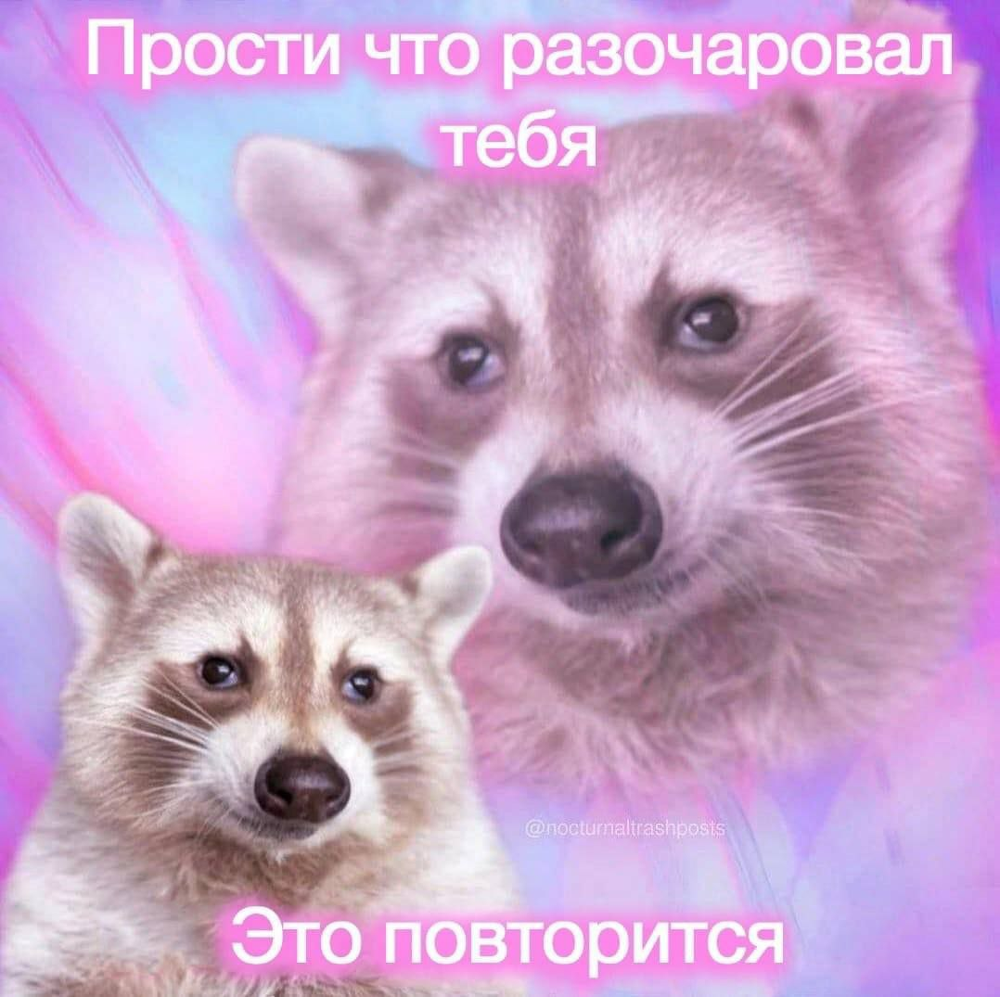

This image is a meme featuring two raccoons against a vibrant, glowing background. The text is in Russian and reads:

- **Top:** "Прости что разочаровал тебя" (Forgive me for disappointing you)
- **Bottom:** "Это повторится" (This will happen again)

The image is a humorous and relatable meme that uses the expressive faces of raccoons to convey a sense of emotional disappointment. The larger raccoon in the background appears to be looking at the viewer with a sad, almost pitying expression, while the smaller one in the foreground looks directly at the viewer with a slightly surprised or confused look. The background has a soft, glowing effect with pink and purple hues, which adds to the dreamy and slightly surreal feel of the image.

The meme is designed to be funny and relatable, using the raccoons' expressions to convey a sense of being let down or disappointed. The text reinforces this message, suggesting that the person who was disappointed will likely be disappointed again. The wa

In [57]:
for image_path in list(Path("raccoons").iterdir())[-1:]:
    image = Image.open(image_path).convert("RGB")
    display(image)
    description = describe_image(image)
    print(description)

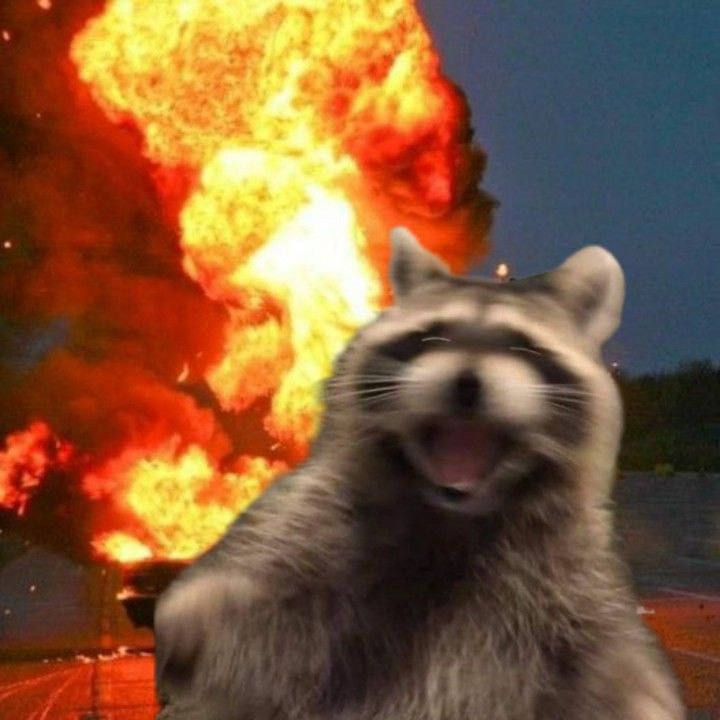

This is a digitally manipulated image featuring a raccoon in the foreground, set against a backdrop of a large, fiery explosion.

- **The Raccoon**: The central figure is a raccoon with a wide, open mouth, appearing to be screaming or laughing. Its fur is a mix of grey, black, and white, and its eyes are wide and dark. The raccoon's face is slightly blurred, giving it a dynamic, almost cartoonish appearance.

- **The Explosion**: In the background, there is a massive explosion. The fire is intense, with bright orange and yellow flames and thick, billowing smoke. The explosion appears to be occurring in a dark, outdoor environment, possibly at night or during twilight, with a dark blue sky.

- **Composition and Style**: The image is a meme, likely created using photo editing software. The raccoon is in the foreground, while the explosion is in the background. The raccoon's face is the main focus, and the explosion serves as a dramatic, chaotic backdrop. The overall style is surreal and 

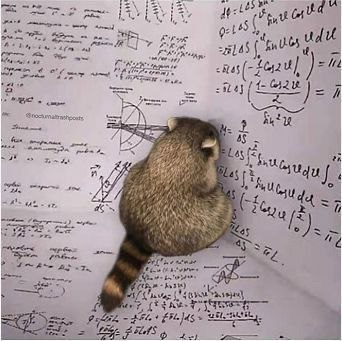

This image features a small raccoon sitting on a sheet of paper covered in complex mathematical equations and diagrams. The raccoon is positioned in the center, with its back to the viewer, and appears to be looking at the equations. The paper is filled with various mathematical expressions, including integrals, logarithmic functions, and geometric shapes. The raccoon's fur is a mix of brown and gray, and its tail has a distinctive black and white ring pattern. The overall image is a surreal and whimsical scene, blending the natural world with the world of mathematics.


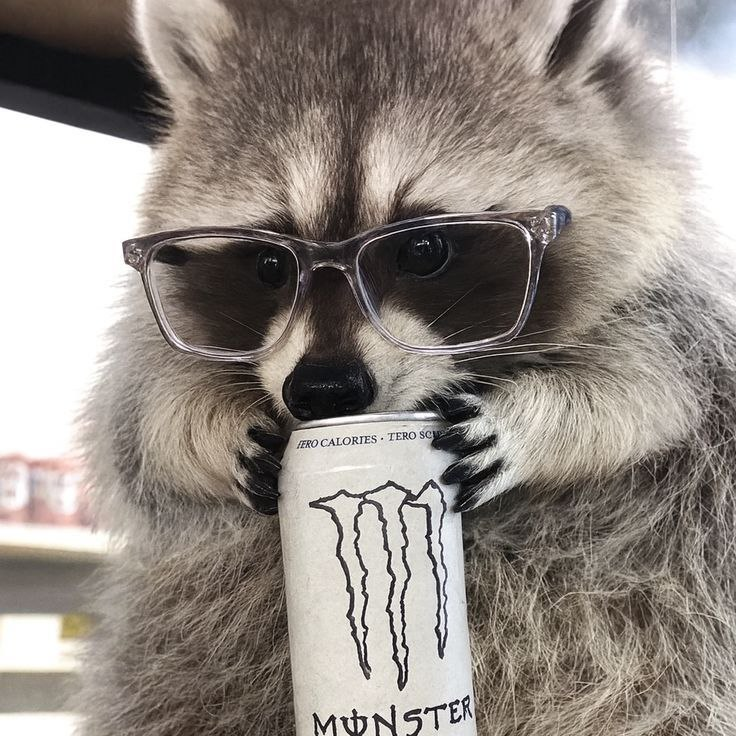

This is a close-up photograph of a raccoon wearing a pair of clear, rectangular glasses and holding a can of Monster energy drink. The raccoon has a grey and white fur coat with a distinct black mask around its eyes. It is holding the can with both front paws, and the can is labeled "ZERO CALORIES" and "TERO SO." The raccoon's eyes are wide and dark, and it appears to be looking directly at the camera. The background is blurred, but it looks like an indoor setting with a window.


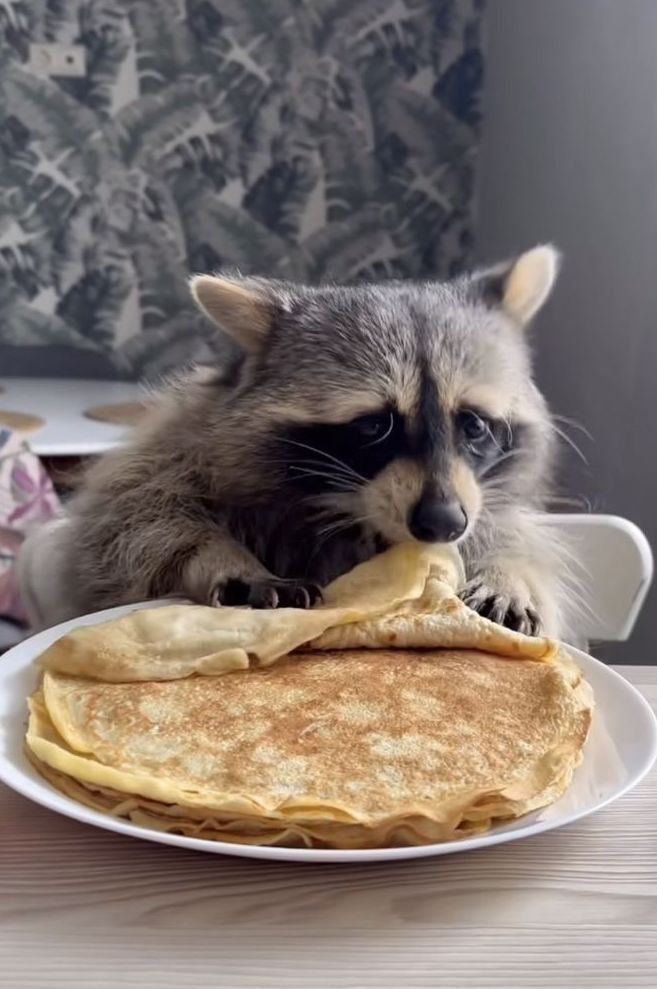

This is a close-up photograph of a raccoon sitting at a table, looking at a large stack of pancakes on a white plate. The raccoon has a grey and black fur coat with a distinctive black mask around its eyes and a black nose. It is leaning forward, with its paws resting on the plate, and appears to be in the process of eating or inspecting the pancakes. The pancakes are golden-brown and stacked high on the plate. The background features a wall with a dark, leafy pattern, possibly a wallpaper. The setting appears to be indoors, likely a kitchen or dining area.


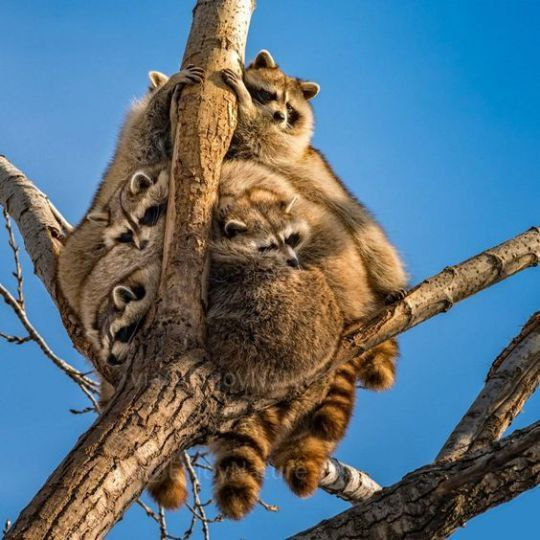

This is a striking, high-angle photograph of a group of raccoons perched on a tree branch against a clear, bright blue sky.

The image features at least four raccoons, with one prominently in the center and others nestled around it. The raccoons are huddled together, creating a cozy, almost familial scene. Their fur is a mix of brown, gray, and black, with the characteristic black "mask" around their eyes and the distinctive striped tails. The raccoons are clinging to the tree, with one on the left gripping the trunk and another on the right resting on a branch. The tree is bare, with visible bark and branches, suggesting it might be a winter or early spring scene. The lighting is bright and natural, highlighting the texture of the fur and the tree. The overall mood is one of warmth and companionship, capturing a moment of quiet, natural life.


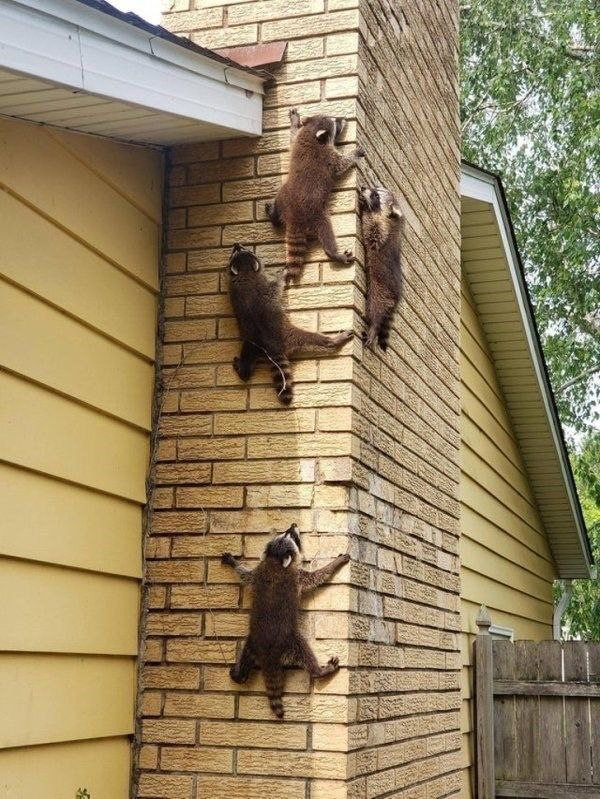

This image captures a humorous and unusual scene of four raccoons climbing a brick chimney on the side of a house. The raccoons are positioned in a vertical line, each clinging to the brick wall with their paws and using their strong claws to grip the surface. The chimney is made of light brown bricks, and the house has yellow siding. The raccoons are all facing the same direction, with their bodies angled upwards. The image is taken from a low angle, looking up at the raccoons. The background includes a wooden fence and some trees. The image is a photograph, not a drawing or painting.


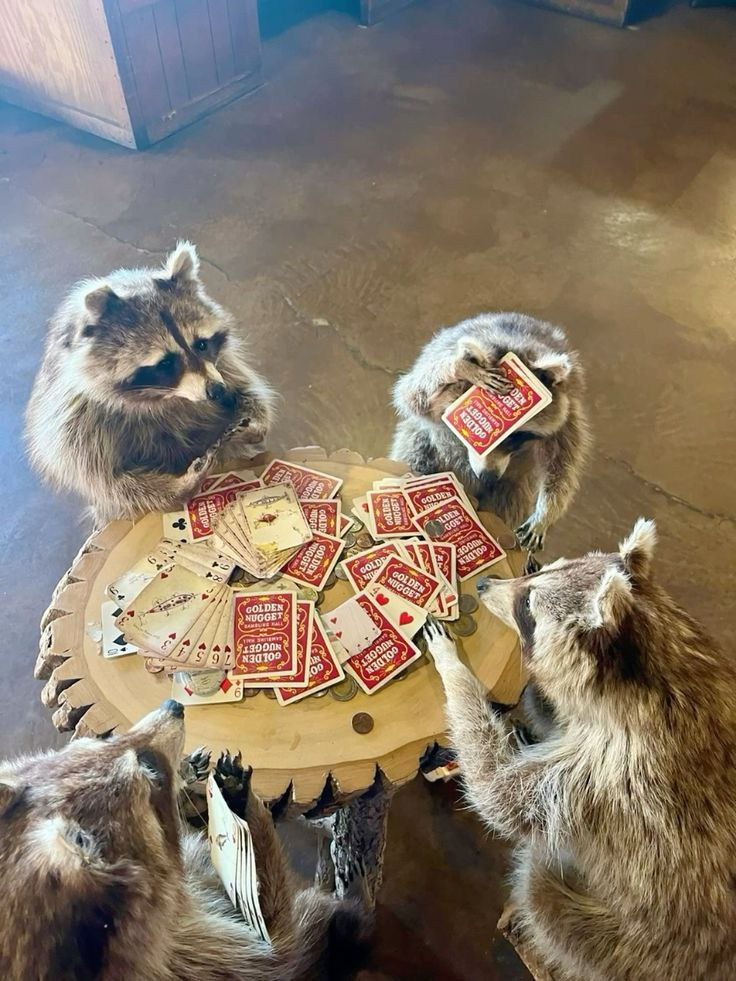

This is a photograph of four raccoons gathered around a small, rustic wooden table, engaged in a game of cards. The scene is set indoors on a concrete floor, with a wooden cabinet visible in the background.

The raccoons are all wearing the same red and white "Golden Nugget" playing cards, which are clearly visible on the table and in the raccoons' hands. The cards are spread out in a fan-like arrangement, and the raccoons are holding them in their paws, as if they are playing a game. The raccoons are all looking at the cards, and one of them is holding a card in its mouth. The table is made of wood and has a natural, rustic appearance. The raccoons are all wearing the same red and white "Golden Nugget" playing cards, which are clearly visible on the table and in the raccoons' hands. The cards are spread out in a fan-like arrangement, and the raccoons are holding them in their paws, as if they are playing a game. The raccoons are all looking at the cards, and one of them is holding a c

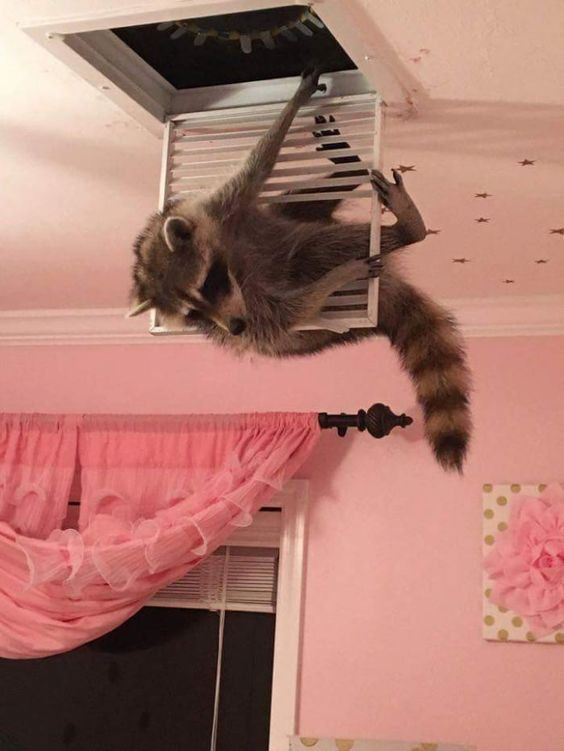

This is a humorous and slightly surreal photograph of a raccoon in a room, seemingly suspended in mid-air.

- **The Raccoon**: The central subject is a raccoon, which is hanging upside down from a white, slatted vent cover. It is gripping the vent with its front paws and is hanging from the vent's edge. The raccoon's body is oriented vertically, with its head and front paws reaching towards the ceiling, and its long, striped tail hanging down. Its face is turned towards the camera, and its eyes appear to be looking down.

- **The Vent**: The raccoon is hanging from a white, rectangular vent cover that is installed in the ceiling. The vent has horizontal slats and is open, with a dark, possibly black, interior visible. The vent is set into a white ceiling, and the raccoon is hanging from the top edge of the vent.

- **The Room**: The room has a pink color scheme. The walls are painted a soft pink, and the ceiling is also pink. There are small, star-shaped decorations on the ceiling. A p

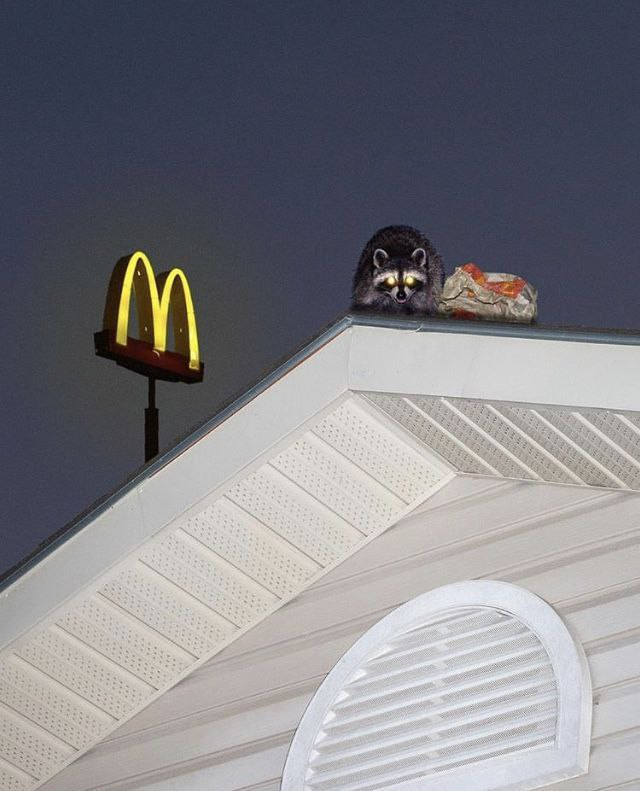

This is a nighttime photograph of a raccoon perched on the roof of a house, with a McDonald's sign in the background.

- **The Raccoon**: The central subject is a raccoon with dark fur and a distinctive mask of white fur around its eyes. Its eyes are glowing with a yellowish light, which is likely from the nearby McDonald's sign. The raccoon is looking directly at the camera, with its head slightly tilted.
- **The House**: The house has white siding and a white, textured roof. A white, arched vent is visible on the lower right side of the image.
- **The McDonald's Sign**: A brightly lit, yellow "M" logo is visible on a pole to the left of the raccoon. The sign is illuminated against the dark sky.
- **The Bag**: To the right of the raccoon, there is a crumpled plastic bag, possibly a takeout bag, with some orange and red markings.
- **The Sky**: The sky is a dark, solid blue-gray, indicating it is either dusk or night.


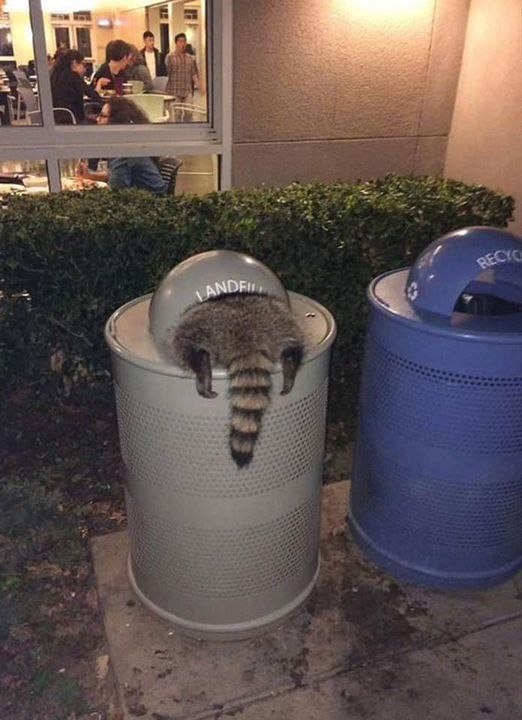

This is a nighttime photograph of a raccoon in a public area, likely a business or office building.

The central focus is a raccoon with its back to the camera, hanging over the top of a light gray, perforated trash can. The can has a dome-shaped lid with the word "LANDFILL" printed on it in black capital letters. The raccoon's tail, with its characteristic black and white ringed pattern, is visible hanging down the side of the can.

To the right of the raccoon is a blue, perforated trash can with a lid that has the word "RECYCLE" printed on it. The two trash cans are placed on a concrete or stone pavement, and there is a low, dense green hedge behind them.

In the background, through a large glass window, several people are visible sitting at tables in what appears to be an office or cafeteria. The scene is illuminated by artificial lighting, and the overall atmosphere is that of a typical urban or commercial environment.


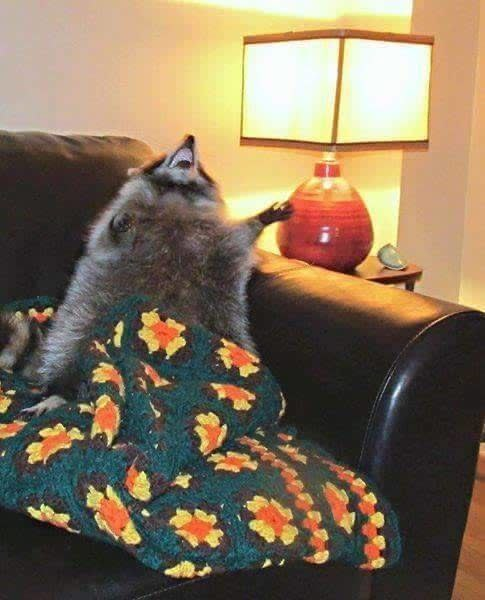

This is a humorous and slightly surreal image featuring a raccoon in a domestic setting.

- **The Main Subject**: A raccoon is the central focus, sitting upright on a black leather couch. It is covered by a crocheted blanket with a dark green base and a pattern of bright orange and yellow flowers. The raccoon is looking upwards, with its head tilted back and its mouth open, as if it is in the middle of a yawn or a playful expression.

- **The Action**: The raccoon is reaching with its right paw towards a red, rounded ceramic lamp base. The lamp is on, casting a warm, yellow light that illuminates the scene. The raccoon's paw is extended, as if it is trying to touch or interact with the lamp.

- **The Setting**: The scene is set in a living room. The black leather couch is prominent, and the lamp is placed on a small side table. The background is a plain, light-colored wall. The overall atmosphere is cozy and domestic, but the raccoon's pose and the lamp's light create a whimsical and s

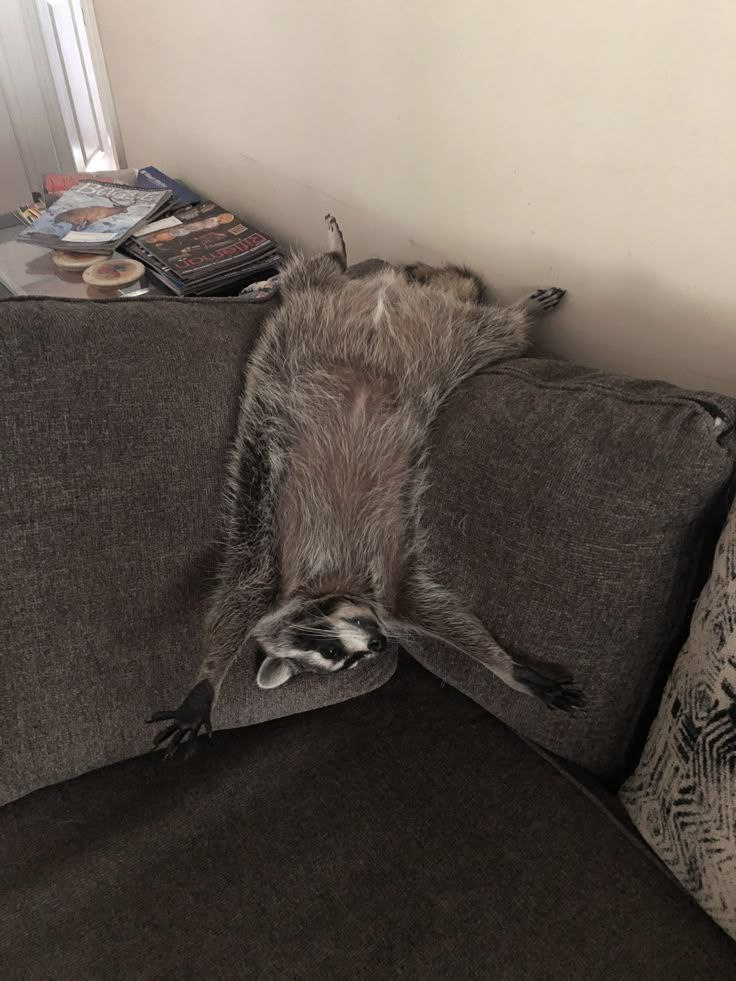

This is a photograph of a raccoon lying on its back on a dark grey couch. The raccoon is positioned with its body stretched out, its legs and paws splayed, and its head turned towards the camera. Its fur is a mix of grey, black, and white, with a distinct black mask around its eyes. The raccoon appears to be resting or sleeping. The couch has a textured fabric and is situated in a corner, with a small table or side table next to it holding a stack of magazines and a few coasters. The background is a plain, light-colored wall, and a window is visible on the left side of the image.


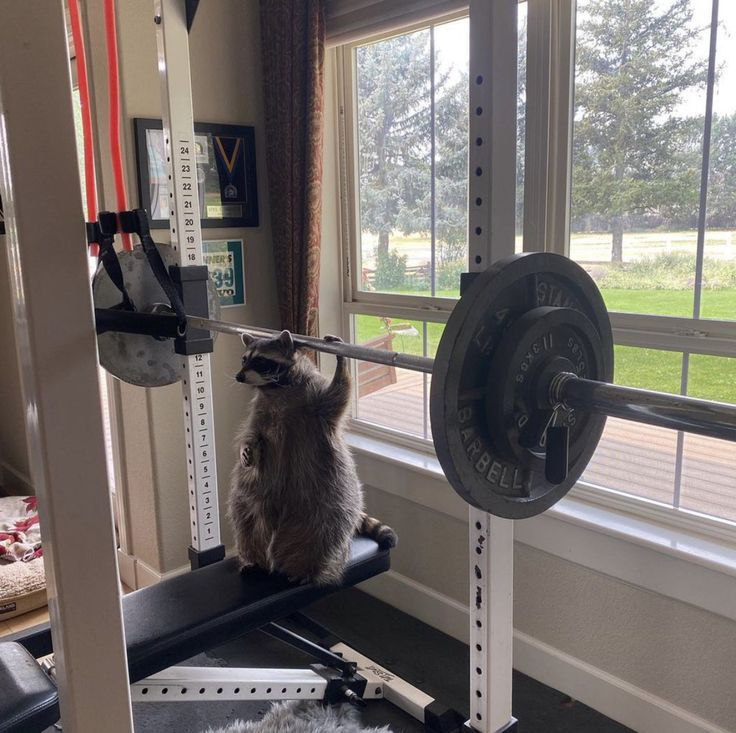

This is a humorous and candid photograph of a raccoon in a home gym, seemingly engaged in a workout.

- **The Raccoon:** The central subject is a raccoon, sitting upright on a black weight bench. It is wearing a small, black, and white harness around its body, which is a common feature in some raccoon training or rehabilitation programs. The raccoon is holding a barbell with both front paws, as if it is lifting it. Its eyes are wide and focused, and its posture suggests it is concentrating on the task.

- **The Gym Equipment:** The raccoon is in a weightlifting area, with a squat rack and a barbell. The barbell is loaded with black weight plates, and the rack has a height scale marked in inches. The raccoon is positioned on the bench, which is part of the squat rack.

- **The Environment:** The setting appears to be a home gym. There is a large window with a view of a green lawn and trees outside. The window has a white frame and is partially covered by a brown curtain. The wall behind

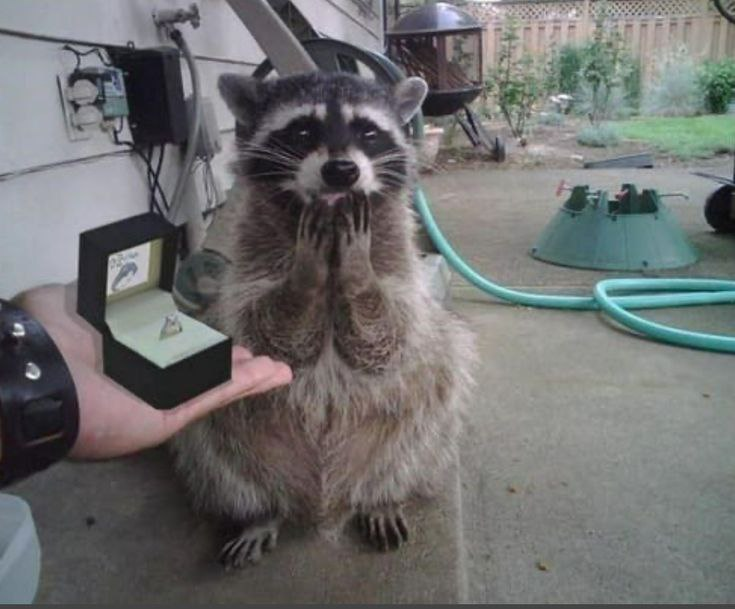

This is a humorous, low-resolution photograph of a raccoon in a backyard setting, reacting to a human's proposal.

- **The Raccoon:** The central subject is a raccoon sitting upright on a concrete patio. It has a very expressive face with wide, dark eyes and a black nose. Its paws are clasped together in a gesture of prayer or awe, and its mouth is slightly open, as if it's about to speak or is in a state of shock. The raccoon's fur is a mix of grey, brown, and black, with a distinct pattern on its face.

- **The Proposal:** A human hand, wearing a black leather wristband, is holding an open black ring box. The box has a light green interior and contains a single ring. The ring appears to be a simple band, possibly a wedding band, and is placed on a small, white, rectangular card that has a small image of a dolphin on it.

- **The Setting:** The scene is a backyard. In the background, there is a wooden fence, a green garden hose, a green plastic object (possibly a lawn sprinkler head),

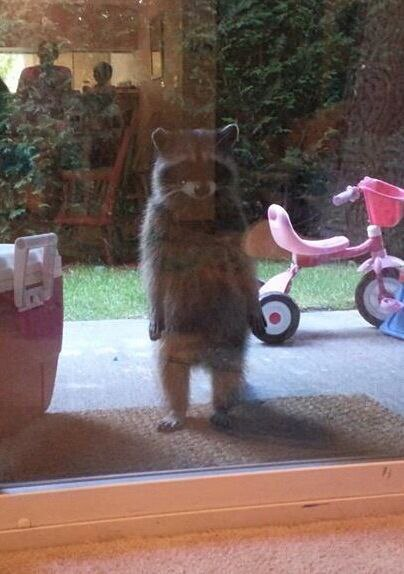

This is a photograph taken from inside a house, looking out through a glass door or window. The central focus is a raccoon standing on its hind legs, facing the viewer. It is positioned on a brown, textured mat, likely a doormat, in front of the glass.

The raccoon has a typical raccoon appearance: a thick, brownish-gray coat with a distinct black mask around its eyes, and a bushy tail. Its front paws are held up, and its body is upright, giving it a curious or alert posture.

The background, visible through the glass, shows a backyard or patio area. To the right of the raccoon, there is a pink children's tricycle with a basket on the handlebar. To the left, a red and white cooler is partially visible. Beyond the tricycle, there is a patch of green grass and some trees or bushes. The reflection on the glass also shows the interior of the house, including a wooden chair and a person in the background.

The overall scene is a candid, humorous moment, capturing a raccoon in a domestic set

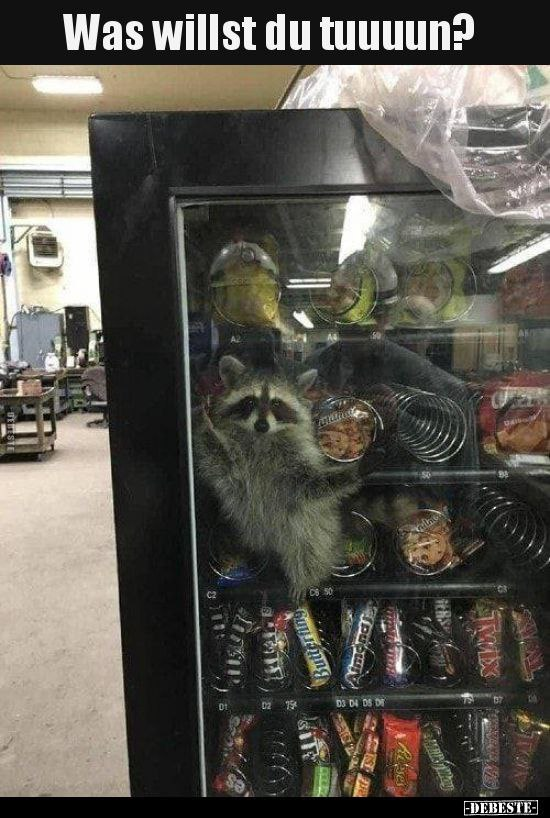

This is a humorous, internet meme-style image featuring a raccoon inside a vending machine. The image is a photograph with a text overlay at the top.

Here is a detailed description of the image:

- **Main Subject**: The central focus is a raccoon with a fluffy, greyish-white fur coat and a distinctive black mask around its eyes. It is standing upright inside a black, glass-fronted vending machine, with its front paws resting on the glass. The raccoon is looking directly at the viewer with a curious and slightly bewildered expression.

- **Vending Machine**: The vending machine is filled with various snacks. The shelves are stocked with:
    - **Candy Bars**: Multiple brands of candy bars are visible, including M&M's, Twix, and other chocolate bars.
    - **Snack Cans**: There are several cans of what appear to be cookies or other baked goods.
    - **Other Items**: A few other items, possibly including a small container of what looks like a drink or a snack, are also visible.

- **Bac

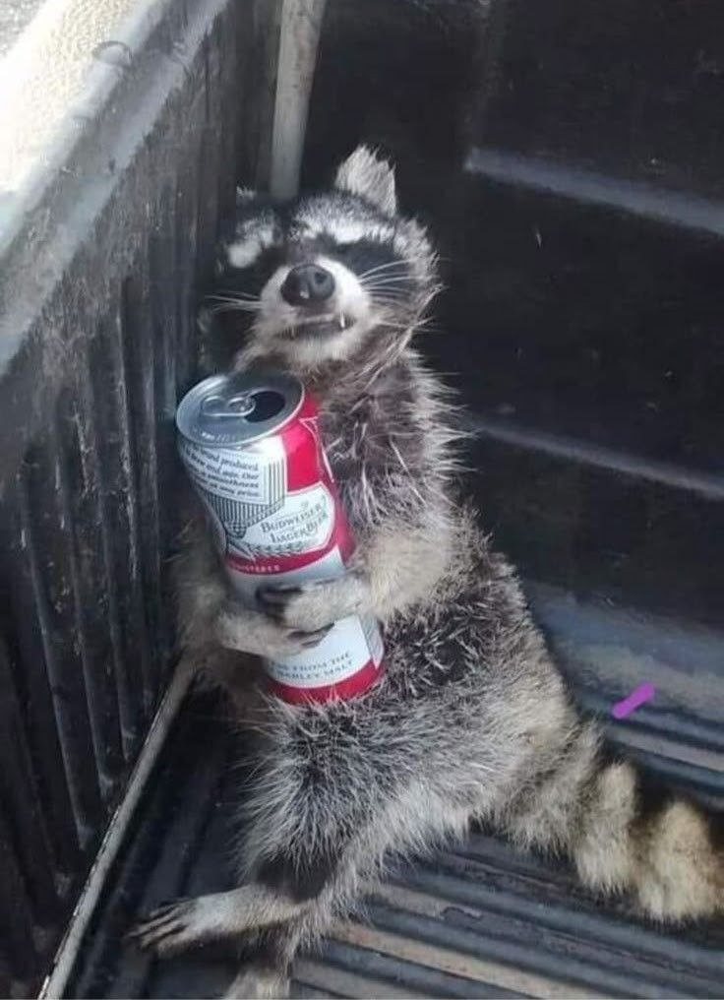

This is a humorous, low-resolution photograph of a raccoon in the bed of a truck. The raccoon is sitting upright, holding a red and silver can of Budweiser Lagerbier (a type of beer) with its front paws. It is positioned in the corner of the truck bed, with its body pressed against the metal side panel. The raccoon's eyes are half-closed, and its mouth is slightly open, giving it a sleepy or dazed expression. Its fur is a mix of gray, black, and white, and its tail is striped. The truck bed is dark and appears to be made of metal. The image is a meme, often used to humorously depict a raccoon as a "drunk" or "drunk" animal.


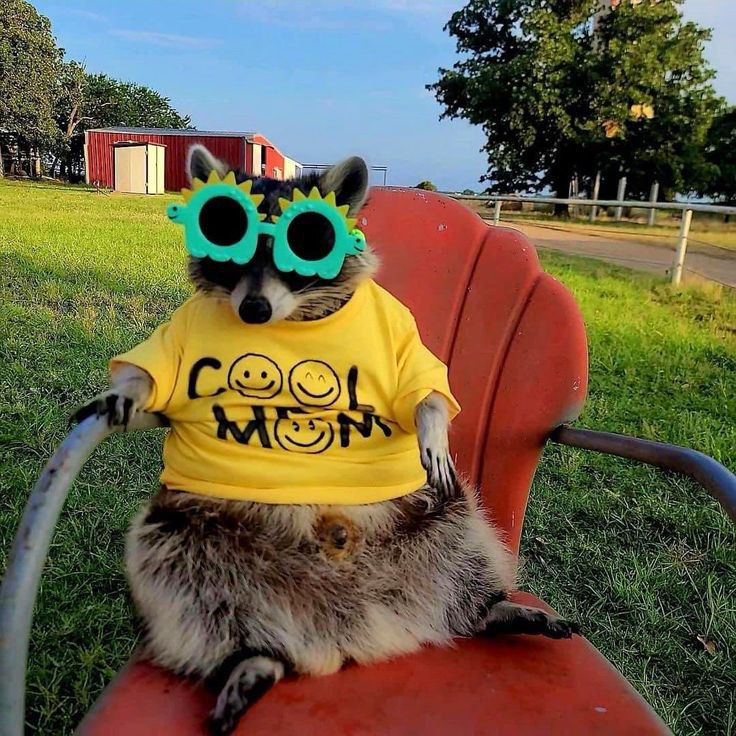

This is a charming and humorous photograph of a raccoon dressed in a playful, human-like outfit, sitting on a red plastic chair in a grassy outdoor area.

Here is a detailed description of the image:

- **The Subject:** The central focus is a raccoon, likely a domesticated or pet one, sitting upright on a red plastic chair. The raccoon is wearing a bright yellow t-shirt with the words "COOL MOM" printed on it in black, accompanied by three smiley face icons.
- **The Attire:** The raccoon is wearing a pair of oversized, novelty sunglasses with a vibrant turquoise frame. The lenses are black, and the frames are decorated with a sunflower-like pattern, giving it a fun, "cool" appearance.
- **The Setting:** The scene is outdoors on a sunny day. The raccoon is sitting on a red plastic chair, which is placed on a green lawn. In the background, there is a red metal building, possibly a shed or a small barn, with a white door. A large, leafy green tree stands to the right, and a paved road is 

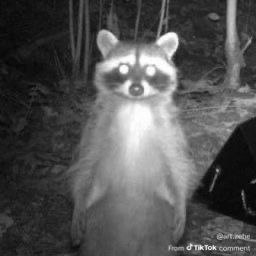

This is a black-and-white, night-vision photograph of a raccoon. The image is taken in a dark, wooded area, likely at night, as indicated by the low-light conditions and the characteristic grainy quality of the image.

The raccoon is the central subject, standing upright on its hind legs. Its face is the most prominent feature, with large, round eyes that are intensely bright, reflecting the camera's infrared light. This creates a striking, almost glowing effect, making the raccoon's eyes appear to be the only part of its face that is illuminated. The raccoon's fur is a mix of light and dark tones, with a distinct dark mask around its eyes and a lighter, fluffy chest and underbelly. Its ears are pointed and alert, and its body is upright, suggesting it is standing still and observing its surroundings.

In the background, the environment is dark and indistinct, with what appear to be tree trunks or branches. On the right side of the image, a dark, possibly black, object is partially vis

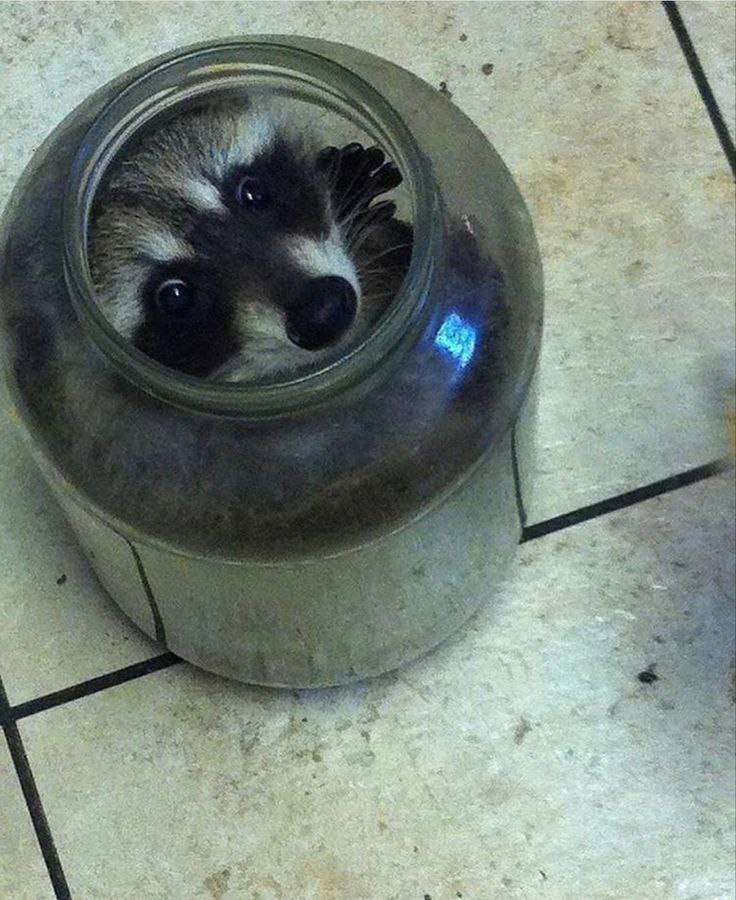

This is a close-up, high-angle photograph of a raccoon peeking out from inside a large, clear glass jar. The jar is sitting on a light-colored, tiled floor with dark grout lines.

The raccoon's face is the central focus, emerging from the top opening of the jar. It has large, dark, round eyes that are wide open and looking directly at the camera, giving it an intense and curious expression. Its fur is a mix of dark gray and black on its face, with a white stripe running down the center of its face, and a white patch on its chin. The raccoon's nose is black, and its whiskers are visible. The raccoon's head is slightly tilted, and its front paws are visible, with one paw raised as if it's waving or reaching out.

The glass jar is transparent, allowing the raccoon's face to be clearly seen. The jar has a thick, cylindrical body and a wide mouth. A small, bright blue reflection is visible on the side of the jar, likely from a light source. The background is the tiled floor, which appears t

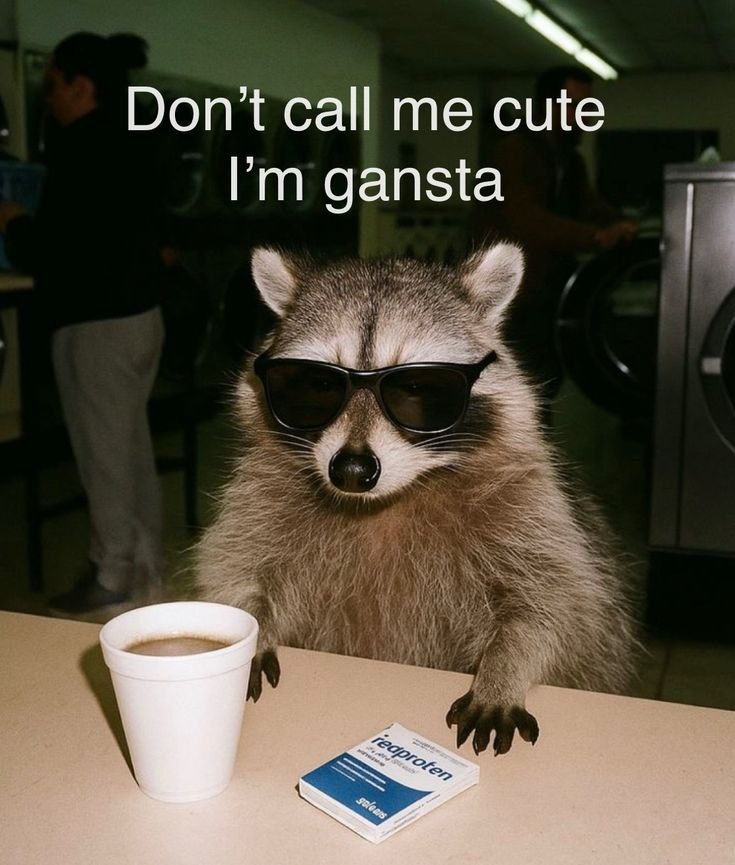

This is a humorous, internet meme-style photograph featuring a raccoon in a laundromat setting.

- **The Subject**: The central focus is a raccoon with a serious, almost defiant expression. It is wearing a pair of black, oversized sunglasses, giving it a cool, "gangsta" vibe. The raccoon is sitting upright on a table, with its front paws resting on the surface.
- **The Setting**: The background is a laundromat. You can see the dark, circular shapes of washing machines, and a person in a black shirt and grey pants standing in the background. The lighting is dim, with a fluorescent light fixture visible at the top of the image.
- **The Objects**: On the table in front of the raccoon are a white styrofoam cup filled with a dark liquid, likely coffee, and a small blue and white box of "reaprotin" (a brand of protein powder). The raccoon is looking directly at the camera.
- **The Text**: Superimposed on the image in white text is the phrase: "Don't call me cute I'm gansta." The word "gansta

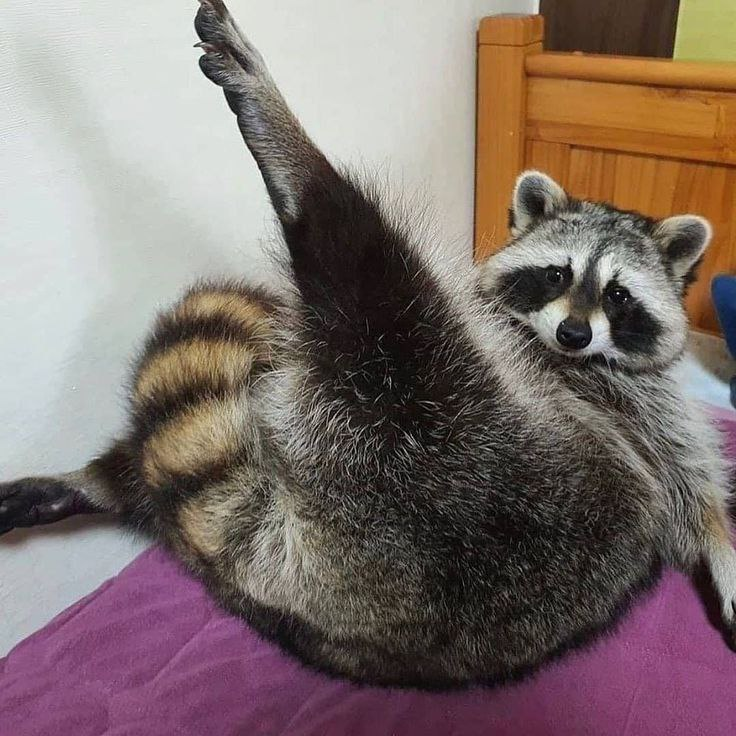

This is a close-up photograph of a raccoon lying on its back on a purple fabric, likely a bedspread or blanket. The raccoon is in a relaxed, playful pose, with its body curled and one front paw raised high in the air, as if it's making a gesture or playfully posing for the camera. Its fur is a mix of gray, black, and white, with the characteristic black mask around its eyes and a ring of black and brown stripes on its tail. The raccoon's eyes are wide and alert, looking directly at the camera. In the background, a wooden headboard of a bed is visible, and the wall is a plain white. The overall image has a humorous and endearing quality, capturing a moment of the raccoon's playful nature.


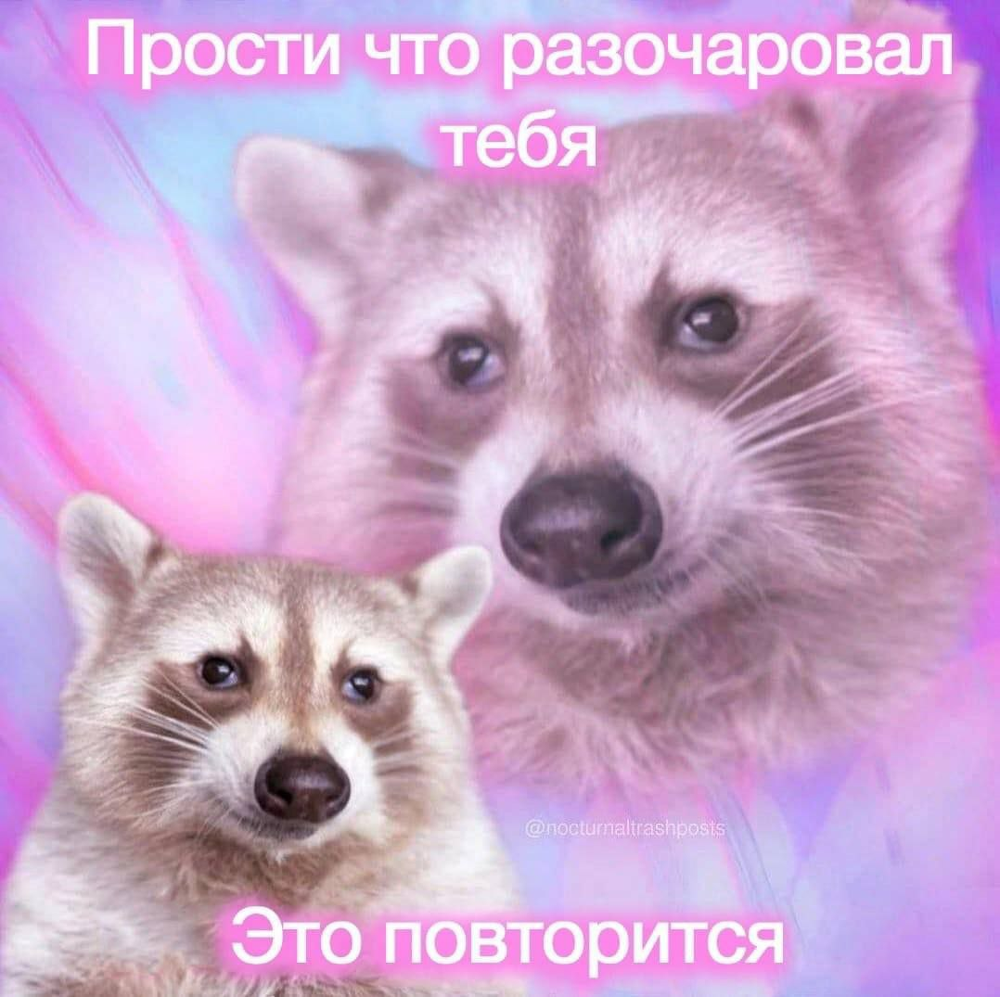

This is a digital image featuring two raccoons against a vibrant, ethereal background. The image is a meme, likely created for social media, and uses the raccoons as a visual metaphor for emotional disappointment.

Here is a detailed description of the image:

- **Main Subjects**: The image prominently features two raccoons. The one in the foreground is smaller and positioned in the lower-left, while the one in the background is larger and positioned in the upper-center. Both have the characteristic facial markings of raccoons, including a dark mask around the eyes and a lighter, almost white, fur on their faces and snouts.

- **Background**: The background is a soft, dreamy blend of pastel colors, primarily pink, purple, and light blue. It has a slightly blurred, ethereal quality, giving the image a magical or surreal feel.

- **Text**: The image contains two lines of text in Russian, written in a white, sans-serif font with a pink glow effect:
    - At the top: "Прости что разочарова

In [65]:
result = {}

for image_path in Path("raccoons").iterdir():
    image = Image.open(image_path).convert("RGB")
    display(image)
    description = describe_image(image)
    print(description)
    result[image_path.name] = description

In [67]:
Path("result.json").write_text(json.dumps(result))

22569